In [1]:
%pylab inline
import numpy as np

#Setup desired trajectory
Triangle = True
Lissajous = False 

#Desired center point of the trajectory
z_height = 1.5 #m
x_point = 0 #m 
y_point = 0 #m 

# Lissajous trajectory features
w = 0.1* 1.5#rad/s
radius = 2 #m
#Generate the lassajous trajectory base on current time
def get_waypoint():
    global theta, last_time, last_point    
    if last_time == 0:
        last_time = time.time() - start_t
    t = time.time() - start_t
    
    vel_mag = get_velocity()
    theta = w * (t + (t - last_time) / vel_mag) #% (2 * math.pi)
    
    #lisarous
    if (t - last_time < 0.1):
        return last_point
    else:
        next_waypoint = [ ((x_point) + 2*radius*math.sin(theta + math.pi/2)),
                          ((y_point) + radius*math.sin(2* theta)),
                          z_height]

        last_time = t
        last_point = next_waypoint
        return next_waypoint
    
# Triangle trajectory features
v = 0.10#m/s
side_length = 3 #m
start_T = 0
#Generate the triangle trajectory base on current time
def get_triangle(t):
    T = side_length / v
    t = t - start_T
    # get three sides depends on time
    if 0 <= t < T:
        next_waypoint = [(x_point) + v*t,(y_point) + 0,z_height]
    elif T <= t < (2*T):
        next_waypoint = [(x_point) + v*T - 0.5*v*(t-T),(y_point) +(math.sqrt(3)/2)*v*(t-T),z_height]
    elif (2* T) <= t < (3*T):
        next_waypoint = [(x_point) + 0.5*v*T- 0.5*v*(t-2*T),(y_point) + (math.sqrt(3)/2)*v*T -(math.sqrt(3)/2)*v*(t-2*T),z_height]
    if t >= 3*T:
        start_T = start_T + 3*T
        return get_triangle(t)
    return next_waypoint

# initial states: [x0, y0, z0, ψ, dx0, dy0, dz0, dψ0]
init_state = [0, 0, 0, 0, 0, 0, 0, 0]
# inertia
I = 0.5 / 4
# mass
m = 0.1
# wings angle 
α = pi/6
# Do we want constains?
en_constrain = True
# simulation time
time_out = 120
tf = time_out
dt = 0.05   # Time step
test_time = linspace(0.,time_out, int(tf / dt) )  # Time interval
print(len(test_time))
# number of motors
n = 2
# position of the thrusters
d = 0.6
p = np.array([[-d, 0, 0], [d, 0, 0]]).T
# tilting angles of the propellers
#α = [-pi/2, pi/2]

# assert np.linalg.matrix_rank(A) == 3
# gravity acceleration
g = 9.8
# max force of a propeller
fM = 0.8
# minimum force of a propeller
fm = 0.01
# desired state
des_state = np.array([0., 0., 0., 0., 0., 0., 0., 0.])
# waypoints
waypoints = [[-2.5, 1.5, 2.5], [0, 1.5, 2.5], [0, -1,2.5], [-2.5, -1, 2.5],[-2.5, 1.5, 2.5]]

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib
2400


In [2]:
# Setup the step function 
Kx = 0.2 # K for x-y plane moving
Ky = 0.2
Kz = 0.1 / 5 # K for lifting
fe = -0.01  # f effective for gravity
Kdrag = 0.5 / 5 # K for draging force
# simulate the air pressure with Z value
K_air = 0.001
# step function for the motion of the s_blimp
def step(state, u):
    #get current state and force 
    x, y, z, ψ, dx, dy, dz, dψ = state
    f1,f2 = u
    
    # accelerations 
    ax = Kx * ((f2 - f1) / m ) * sin(ψ) - Kdrag * 2 * dx 
    ay = Ky * ((f2 - f1) / m ) * cos(ψ) - Kdrag * 2 * dy 
    aψ = (d * (f1 + f2) / I - Kdrag  * dψ*dψ)
    az = Kz * sin(α) * dψ * dψ + fe/m -Kdrag*10 * dz 
    # velovity
    dx += ax * dt
    dy += ay * dt
    dz += az * dt
    dψ += aψ * dt
    # position
    x += dx * dt
    y += dy * dt
    z += dz * dt
    ψ += dψ * dt
    if z < 0:
        z = 0
    # return new state
    new_state = np.array([x, y, z, ψ, dx, dy, dz, dψ])
    return new_state

In [7]:
# Setup the control function
Kpz = 0.1 * 5 #K for height control
# testing force u_log
u_log = [[0,0]]
# get control value u from current state and desire state
def control(state, des_state, en_constrain):
    #get error based on states 
    x, y, z, ψ, dx, dy, dz, dψ = state[0:9]
    err = des_state - state
    err_pos = err[0:3]
    # generate hovering force
    hw = Kpz * err_pos[2]
    u = [0,0]
    # Bangbang control
    # get desired moving angle from error in x-y plane
    theta = np.arctan2(err_pos[1],err_pos[0])
    # get control value base on desired moving angle and current facing angle 
    tau = 0.2
    if pi <= ((ψ + theta) % (2*pi)) and ((ψ + theta) % (2*pi)) < 2*pi :
        u = [hw + tau, hw - tau]
    else:
        u = [hw - tau, hw + tau]
    #clamp the force
    clamp(u,fm,fM)
    return u
# clamp function 
def clamp(vec, minimum, maximum):
    for i in range(len(vec)):
        if vec[i] < minimum:
            vec[i] = minimum 
        elif vec[i] > maximum:
            vec[i] = maximum
    return vec

In [8]:
# setup of simulate function
# return desired force and new state after one step
def simulate(state, des_state):   
    f = control(state, des_state, en_constrain)
    state = step(state, f)
    return state, f
import csv

#length of the simulate
length = int(time_out/dt)
#log file for simulate
state_log = np.zeros((length, 8))
f_log = np.zeros((length, n))
state = init_state
count = 0

# go to the desired position based on states
def goto_point(state,des_state,count):
    state, f = simulate(state, des_state)
    state_log[count, :] = state 
    f_log[count, :] = f 
    return state

# get distance of two point
def get_distance(p1,p2):
    difference =np.subtract(p1,p2)
    distance_r3 = norm(difference)
    return distance_r3

# generate trajectory and go to desired point
for t in range(0,test_time):
    p_now = state[0:3]
    p_des = get_triagle(t)
    
# traverse all waypoints
for point in waypoints:
    if count > length -1:
        break
    p_now = state[0:3]
    p_des = np.array(point)
    des_state[0:3] = p_des
    distance = get_distance(p_now,p_des)
    # go to current waypoint until close enouth
    while distance > 0.3:
        if count > length -1:
            break
        p_now = state[0:3]
        p_des = np.array(point)
        des_state[0:3] = p_des
        distance = get_distance(p_now,p_des)
        state = goto_point(state, des_state, count)
        count = count + 1


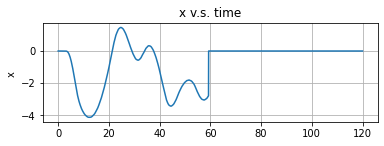

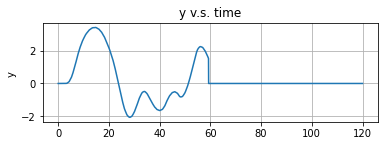

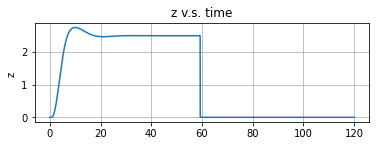

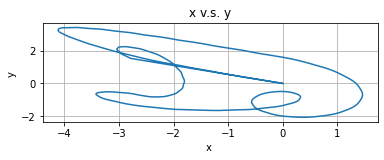

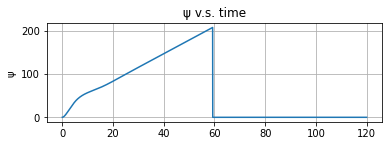

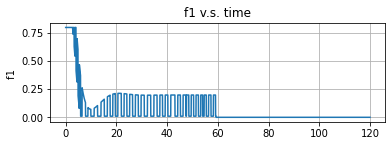

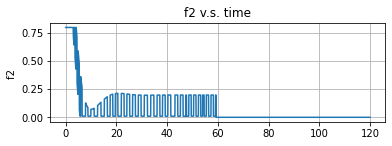

In [9]:
# Generate plots based on log file
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("x ")
ax21.set_title('x v.s. time')
#x_position, = ax21.plot(state_log[:, 0],state_log[:, 1])
x_position, = ax21.plot(test_time, state_log[:, 0])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("y ")
ax21.set_title('y v.s. time')
x_position, = ax21.plot(test_time, state_log[:, 1])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("z ")
ax21.set_title('z v.s. time')
x_position, = ax21.plot(test_time, state_log[:, 2])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_xlabel("x ")
ax21.set_ylabel("y ")
ax21.set_title('x v.s. y')
x_position, = ax21.plot(state_log[:, 0],state_log[:, 1])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("ψ ")
ax21.set_title('ψ v.s. time')
# x_position, = ax21.plot(test_time, state_log[:, 3]% (2*pi))
x_position, = ax21.plot(test_time, state_log[:, 3])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("f1 ")
ax21.set_title('f1 v.s. time')
x_position, = ax21.plot(test_time, f_log[:, 0])

fig2 = plt.figure()
ax21 = fig2.add_subplot(211)
ax21.grid()
ax21.set_ylabel("f2 ")
ax21.set_title('f2 v.s. time')
x_position, = ax21.plot(test_time, f_log[:, 1])


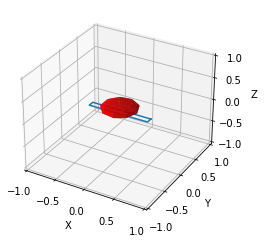

In [11]:
# sphere model
def plot_globe(a,b,c,r,rotate,dense=10):
    c = c + r/3
    t1=np.linspace(0,np.pi,dense)
    t2=np.linspace(0,np.pi*2,dense)
    t1,t2=np.meshgrid(t1,t2)
    x=a+r*np.sin(t1)*np.cos(t2+rotate)
    y=b+r*np.sin(t1)*np.sin(t2+rotate)
    z=c+r*np.cos(t1)/3
    return x,y,z
# box model
def box_points(w, h, z):
    points = np.zeros([5,3])
    points[0] = [ + w/2, + h/2, z]
    points[1] = [ + w/2, - h/2, z]
    points[2] = [ - w/2, - h/2, z]
    points[3] = [ - w/2, + h/2, z]
    points[4] = [ + w/2, + h/2, z]
    return points
# combine two models to generate robot
def box_se2(x, y, z, α, ϕ, θ, ψ, u, w=1, h=.05, ax = plt.axes(projection='3d')):
    ψ = -ψ
    points = box_points(w, h, 0)
    # Rotation matrix
    R = [[cos(ψ), -sin(ψ), 0], 
         [sin(ψ), cos(ψ), 0],
         [0, 0, 1]]
    
    # Rotate
    points = [np.dot(R, p) for p in points]    
    points = array(points)

    # translate
    points[:,0] += x
    points[:,1] += y
    points[:,2] += z
    
    # propellers arrows length
    e1 = [1,0,0]    
    prop_x = array([sin(ψ), cos(ψ)])
    prop_y = array([sin(ψ), cos(ψ)])
    prop_z = array([0,0])
        
    # Plot propellers (start points)
    px = points[1:3,0] * 0.8
    py = points[1:3,1] * 0.8
    pz = points[1:3,2] * 0.8
    
    #draw blue arrows
    #ax.quiver(px, py, pz, 2*prop_x, 2*prop_y, 1*prop_z, color="blue")
    #draw blue box
    ax.plot(points[:,0],points[:,1], points[:,2])
    #draw red arrows with force
    #ax.quiver(px, py, pz, u*prop_x, u*prop_y, u*prop_z, color='r')
    
    a,b,c=plot_globe(a=x,b=y,c=z,r=0.3,rotate = ψ)
    
    ax.plot_surface(a,b,c,color="r",alpha=0.8)
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.set_xlim3d((-1., 1.))
    ax.set_ylim3d((-1., 1.))
    ax.set_zlim3d((-1., 1.))

x, y, z, α, ϕ, θ, ψ  = 0,0,0, pi/6, 0, 0, 0.0
box_se2(x, y, z, α, ϕ, θ, ψ , [1,1], w=1, h=0.1)

#plot(x,y,z, 'o')
grid()

Animation size has reached 20986735 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


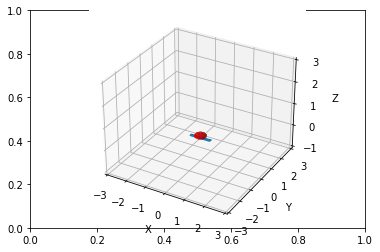

In [12]:
# Generate animation
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML

fig,ax = plt.subplots()
ax = plt.axes(projection='3d')
def animate(t):
    ax.clear()       
    x, y, z, ψ, dx, dy, dz, dψ = state_log[t][0:9]
    
    u = f_log[t]
    #a_lift = 0.5 * sin(α) * (abs(u[0]) + abs(u[1])) - g
    # box points
    box = box_se2(x, y, z, α, ϕ, θ, ψ, u, w=1, h=0.1, ax=ax)
    #plt.plot(state_log[0],state_log[1],state_log[2], 'b')
    # Initial conditions
    #ax.plot(t, x_log[t,0],  'bo')
    ax.set_xlim((-3, 3))
    ax.set_ylim((-3, 3))
    ax.set_zlim((-1, 3))

anim = animation.FuncAnimation(fig, animate, frames=len(test_time), interval=60)
anim.save('S_blimp.gif',writer = 'pillow')
HTML(anim.to_jshtml())